README:
    1. Generate seperate plots for unique combinations of: PRDS, METHOD#, Parameter Name, Manufacture Building, Test Site
    2.Moving Average plot: limited to parameters w/ >50 batches; can be changed
    3. moving window=20; can be changed
    4. Test Site: extracted from the last 3 letters of "unit procedure"
    5. This is the most up-to-date script for rolling chart in this folder.

In [1]:
import pandas as pd
import numpy as np

In [2]:
import datetime

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
from matplotlib.backends.backend_pdf import PdfPages
#pp = PdfPages('multipage.pdf')

#plt.savefig(pp, format='pdf')

#pp.savefig()

#pp.close()


In [5]:
from APRGenerator import APR_analytical_pipeline as apr

In [6]:
def parse_date(string):
    return(string[:10])

def parse_test(string):
    return(string[-3:])

def parse_mfg(string):
    return(string.split("-")[0])

In [9]:
program="methods"
file_path="Method_Component_CleanedData14Dec18.csv"

In [30]:
#Minimal number of assays/batches for parameters to be included in the visualization
n=30

In [10]:
pipeline=apr(program, file_path)

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2850: DtypeWarning: Columns (7,16,17) have mixed types. Specify dtype option on import or set low_memory=False.
  if self.run_code(code, result):


In [11]:
df=pd.read_csv("Method_Component_CleanedData14Dec18.csv")

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2728: DtypeWarning: Columns (7,16,17) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [13]:
df.columns

Index(['Assay Id', 'procedure_id', 'component_name', 'assay_start_date',
       'Value', 'Value (Text)', 'Assay Status', 'valid', 'Test Site',
       'Data Source', 'lcl', 'cl', 'ucl', 'orig_control_lot',
       'Current Component', 'Current Method Id', 'lal', 'ual', 'Column 6',
       'Reformatted Lot Number', 'Measurement', 'Method Number',
       'Lower Control Limit', 'Upper Control Limit', 'Centerline',
       'Assay Start Date', 'Valid Result', 'Invalid Result',
       'Upper Acceptance Limit', 'Lower Acceptance Limit', 'Control Lot',
       'Filtered out at 2:36:11 PM', 'Trendable'],
      dtype='object')

In [21]:
df_valid=df[df.valid==True]

In [23]:
df_valid.shape

(109006, 33)

In [25]:
para_unit_pair_df=df_valid[['Method Number','component_name','Test Site']].drop_duplicates()

In [28]:
df_valid=df_valid.sort_values(['Method Number','component_name','Test Site','Assay Start Date'])
df_valid=df_valid.reset_index(drop=True)

In [29]:
df_valid.groupby(['Method Number','component_name','Test Site']).size()

Method Number  component_name                            Test Site
176            Ctrl Standard % B.A. Rec[T]               AML             1
               Prd Ctrl % B.A. Rec[T]                    AML             1
A0105_FORM     pH 5.00 Buffer Value[T]                   ADL             1
A01256         High Ctrl Result [Rec][T]                 AML            68
               Low Ctrl Result [Rec][T]                  AML            68
               Med Ctrl Result [Rec][T]                  AML            68
MET-000079     Initial Ref Std SA_N[T]                   AML             2
MET-000084     Negative Control                          ACO           561
                                                         ARI          1939
                                                         ASM           242
               Negative Control FAM Signal               ACO           561
                                                         ARI          1939
                                 

In [14]:
df=pipeline.df_colname_unify(df)

df=pipeline.specs_num_conversion(df)

In [139]:
#df_quan=pipeline.spec_correction_rawset(df_quan)

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:194: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


In [31]:
inclusion_indicator=pd.DataFrame(df_valid.groupby(['Method Number','component_name','Test Site']).size()>=n)

In [32]:
inclusion_indicator.reset_index(inplace=True)

In [34]:
combs=inclusion_indicator[['Method Number','component_name','Test Site']][inclusion_indicator[0]]

In [40]:
len(combs)

578

In [34]:
df_quan["Mft_Date_Batch"]=pd.Series(list(map(parse_date,df_quan["date of manufacture"].astype(str))))\
                                +"--"+df_quan['batch number'].astype(str)

np.sqrt(1-0.94**2)/0.94

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=20,center=False).mean()
  from ipykernel import kernelapp as app
/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=10,center=False).mean()
  from ipykernel import kernelapp as app


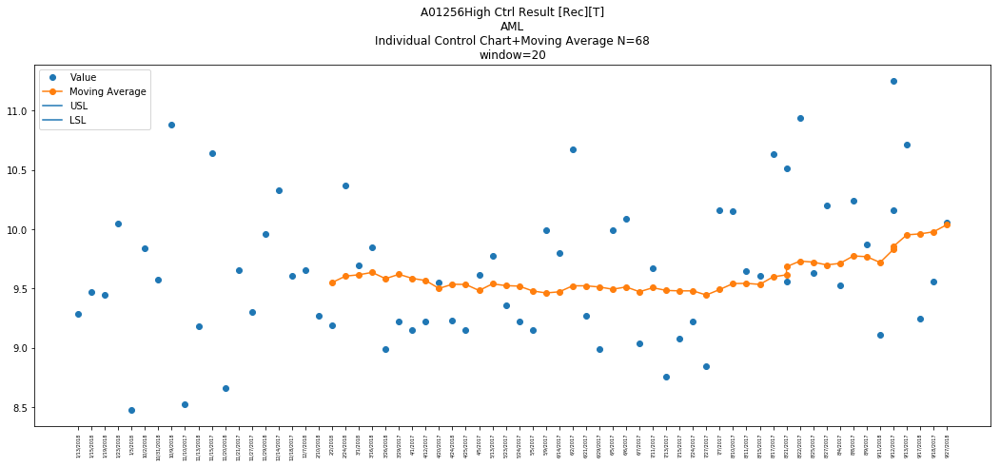

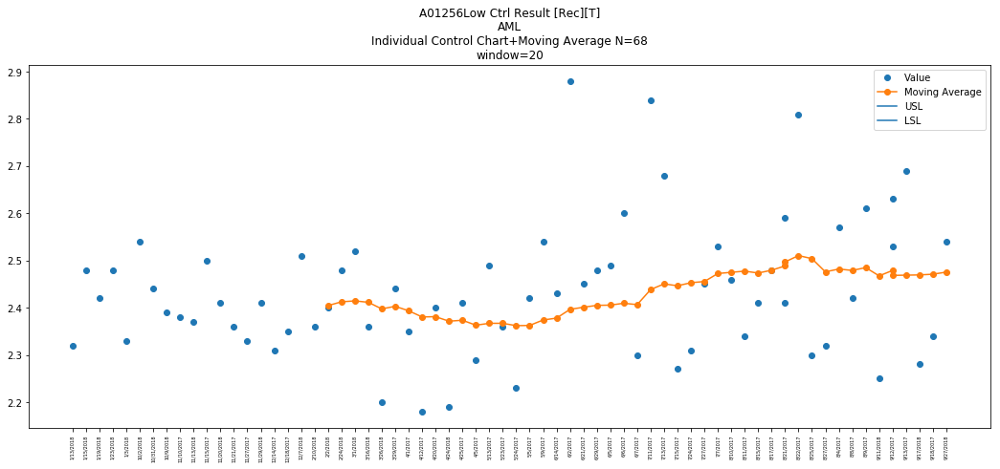

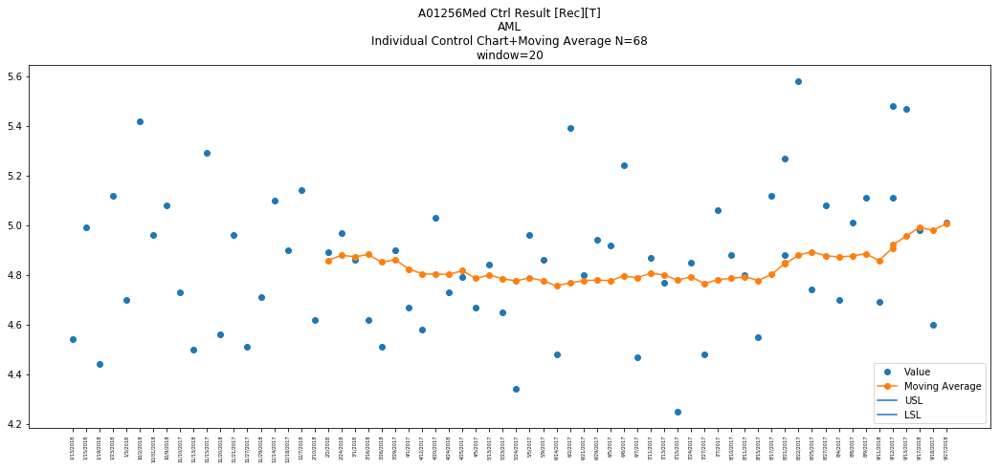

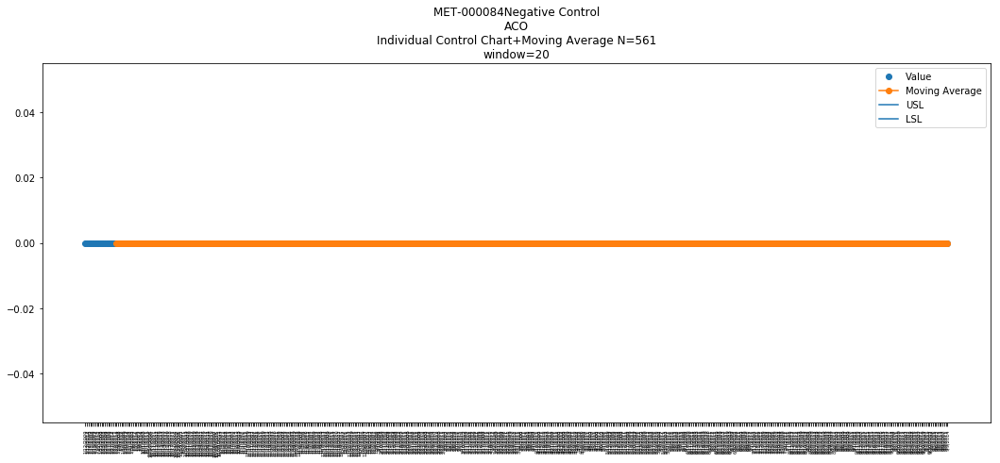

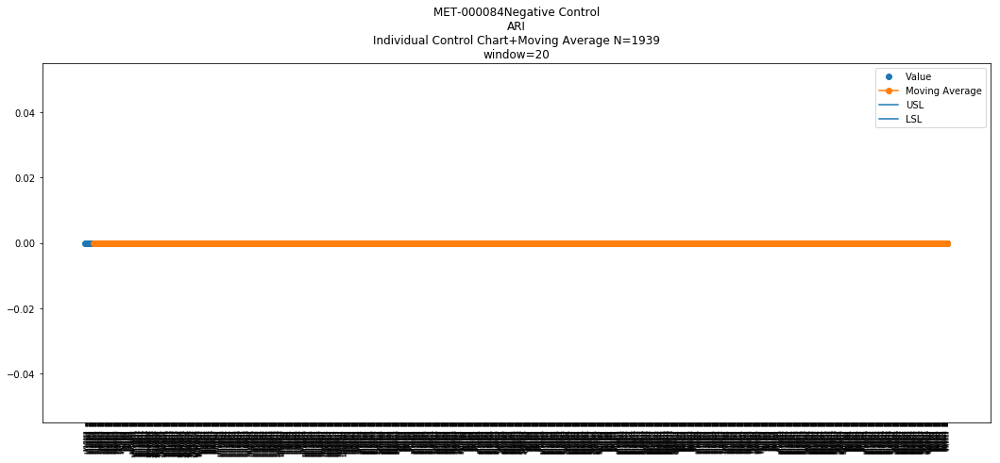

...

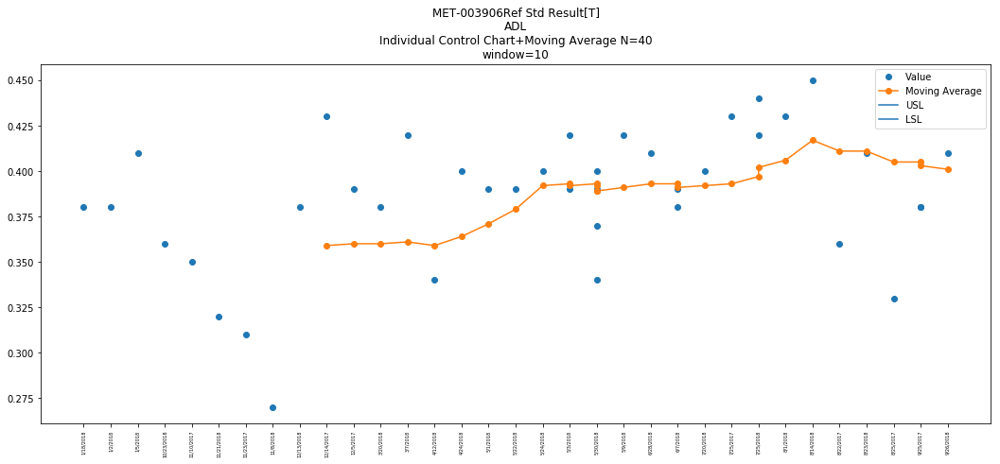

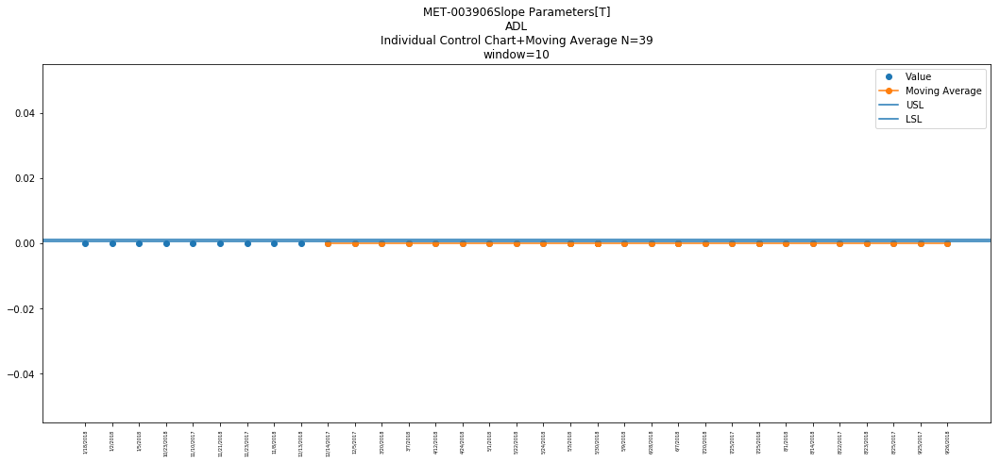

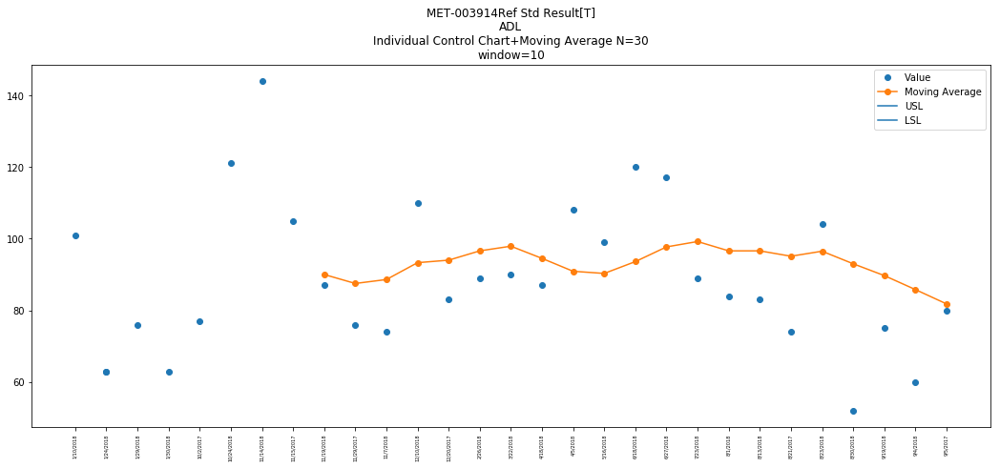

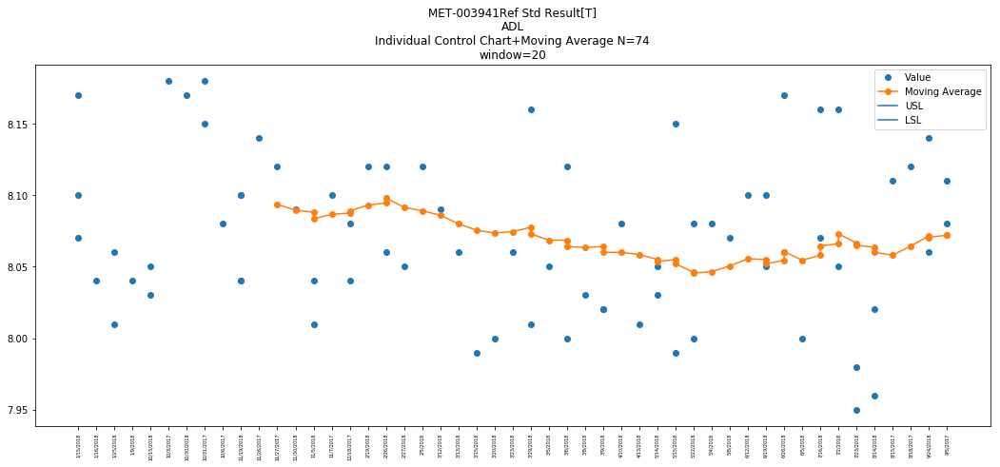

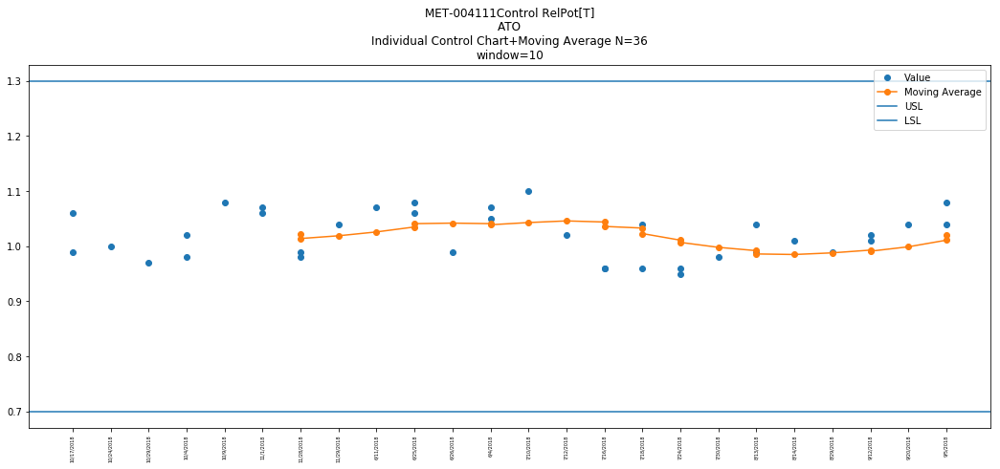

In [45]:
pp = PdfPages('MovingAverage-Method.pdf')
#plt.figure(figsize=(10,75))
for i in range(len(combs)):
    comp=combs['component_name'].iloc[i]
    test=combs['Test Site'].iloc[i]
    mtd=combs['Method Number'].iloc[i]
    sub_df=df_valid[(df_valid['component_name']==comp)&(df_valid["Test Site"]==test)&(df_valid["Method Number"]==mtd)].copy()
  
    sub_df=sub_df.sort_values(by=['Assay Start Date'])
    if len(sub_df)>50:
        width=20
    else:
        width=10
    
    moavg=pd.rolling_mean(sub_df['Value'],window=width)
   
    sample_std=np.std(sub_df['Value'],ddof=1)
    sample_mean=np.average(sub_df['Value'])
    indexes=moavg[moavg.notnull()].index
    ual=sub_df['Upper Acceptance Limit'].iloc[-1]
    lal=sub_df['Lower Acceptance Limit'].iloc[-1]

    ax=plt.figure(figsize=(18,7))

    plt.plot(sub_df['Assay Start Date'],sub_df["Value"],"o")
    plt.plot(sub_df['Assay Start Date'].loc[indexes],moavg[indexes],"-o",label="Moving Average")
    #if ((ual!=".")&(lal!=".")):
        #plt.axhline(y=(ual+lal)/2,label="(USL+LSL)/2")
    if (ual!="."):
        plt.axhline(y=ual,label="USL")
    if(lal!="."):
        plt.axhline(y=lal,label="LSL")  
    
    
    #plt.axhline(y=sample_mean+3*sample_std/np.sqrt(width),label="UCL for MA",linestyle="--",color="orange")
    #plt.axhline(y=sample_mean-3*sample_std/np.sqrt(width),label="LCL for MA",linestyle="--",color="orange")

    plt.title(mtd+comp+"\n"+test+"\n"+"Individual Control Chart+Moving Average"+" N="+str(len(sub_df))\
              +"\n"+"window="+str(width))
    plt.legend()
    #plt.xticks([], [])
    
    #plt.plot(sub_df["Mft_Date_Batch"].iloc[0::10],sub_df['value_num(recorded/full precision)'].iloc[0::10],"o",alpha=0,color="red")
    plt.xticks(rotation=90,fontsize=5)
    #plt.axvline(x=sub_df["Mft_Date_Batch"].iloc[0::2],linewidth=2,linestyle="--")
    plt.savefig(pp, format='pdf',bbox_inches="tight");
pp.close()

pp = PdfPages('MovingAverageEnbrelPRJU:APR14-AML14.pdf')
#plt.figure(figsize=(10,75))

prds="PRDS-002411"
para="pH"
mfg="PRJU:APR14"
test="AML"
mtd="MET-001215"
sub_df=df_quan[(df_quan["parameter detail"]==prds)&(df_quan["parameter name"]==para)&\
               (df_quan['mfg_site_bldg']==mfg)&(df_quan["test site"]==test)].copy()
sub_df=sub_df.sort_values(by=["date of manufacture",'batch number'])

width=20

        
    
moavg=pd.rolling_mean(sub_df['value_num(recorded/full precision)'],window=width)
   
    
sample_mean=np.average(sub_df['value_num(recorded/full precision)'])
indexes=moavg[moavg.notnull()].index
ual=sub_df["UAL"].iloc[-1]
lal=sub_df["LAL"].iloc[-1]

ax=plt.figure(figsize=(18,7))

plt.plot(sub_df["Mft_Date_Batch"],sub_df['value_num(recorded/full precision)'],"o")
plt.plot(sub_df["Mft_Date_Batch"].loc[indexes],moavg[indexes],"-o",label="Moving Average")

plt.axhline(y=sample_mean+3*sample_std/np.sqrt(width),label="UCL for MA",linestyle="--",color="orange")
plt.axhline(y=sample_mean-3*sample_std/np.sqrt(width),label="LCL for MA",linestyle="--",color="orange")

plt.title(prds+"\n"+mtd+"--"+para+"\n"+mfg+"-"+test+"\n"+"Individual Control Chart+Moving Average")
plt.legend()
plt.xticks(rotation=90,fontsize=3)
    
plt.savefig(pp, format='pdf',bbox_inches="tight");
pp.close()

In [5]:
df2["Manufacture Date"]=pd.to_datetime(df2["Manufacture Date"])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=15,center=False).std()
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=15,center=False).mean()
  from ipykernel import kernelapp as app
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=10,center=False).std()
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=10,center=False).mean()
  from ipykernel import kernelapp as app
/usr/local/lib/python3.6

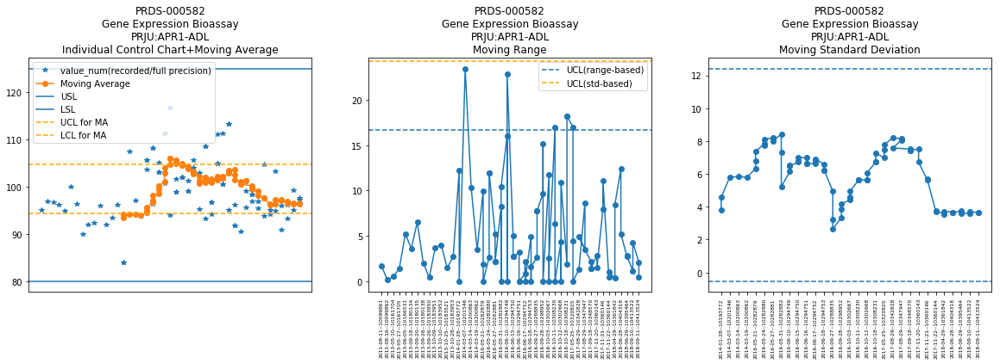

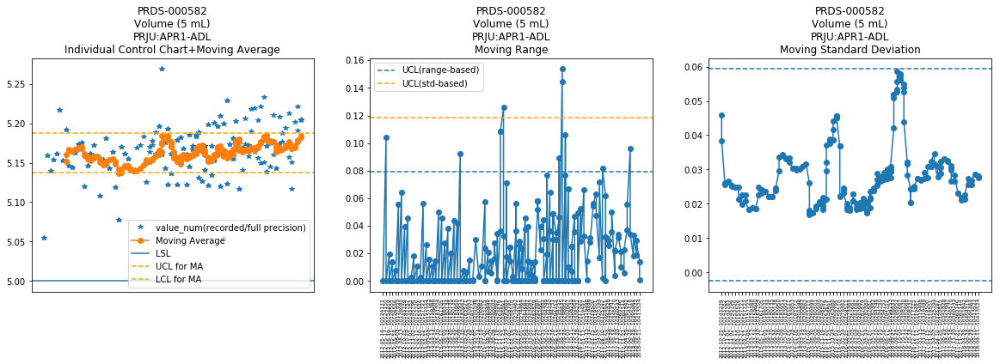

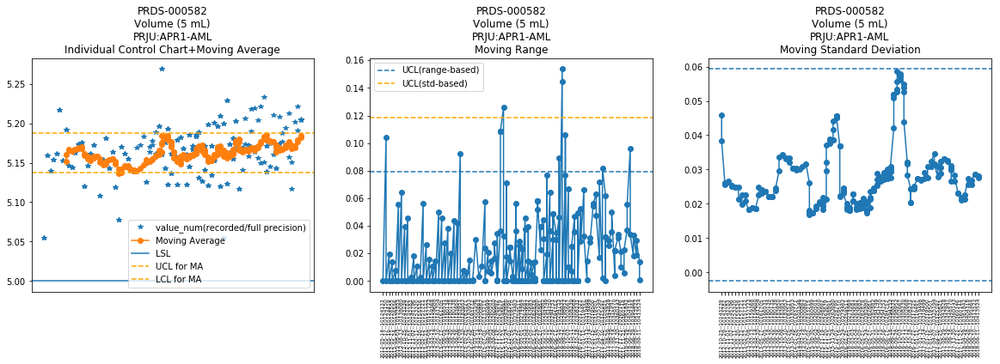

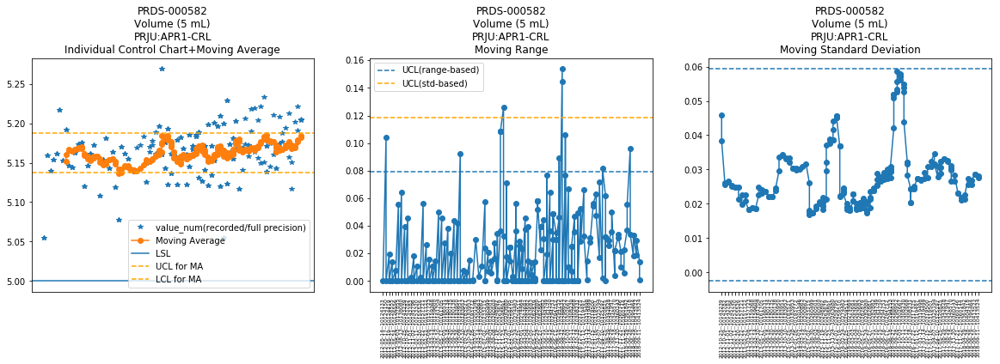

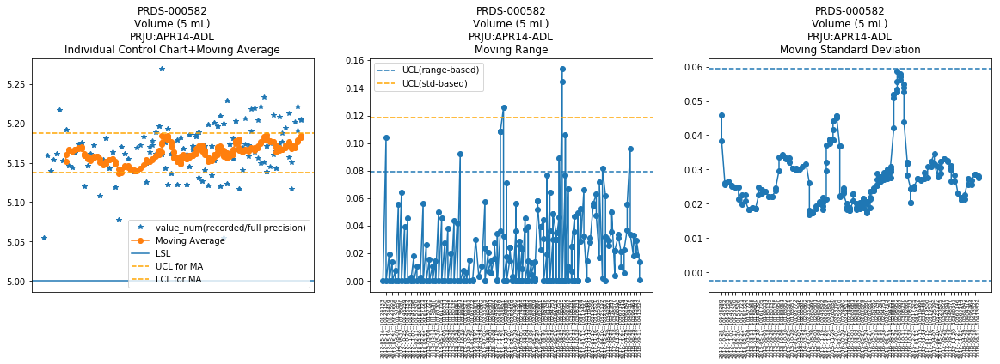

...

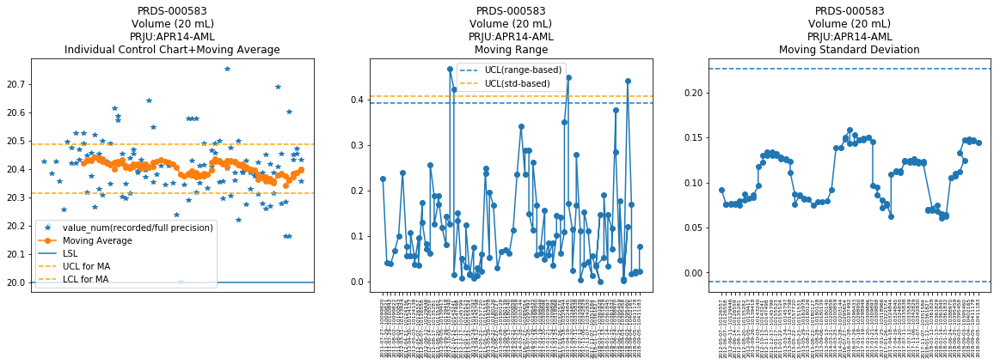

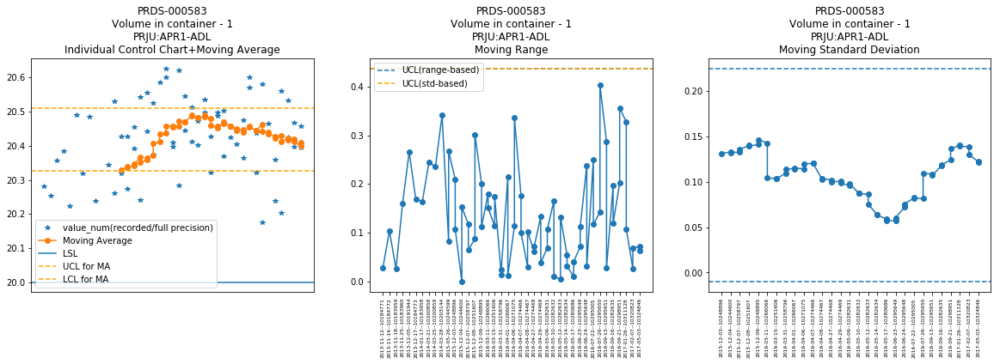

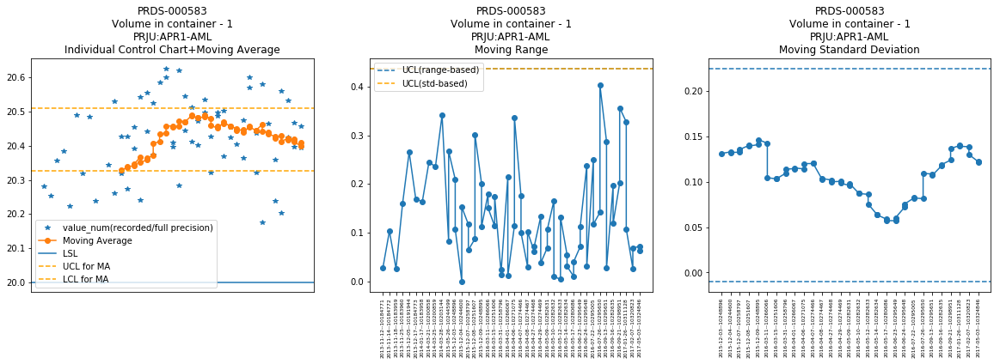

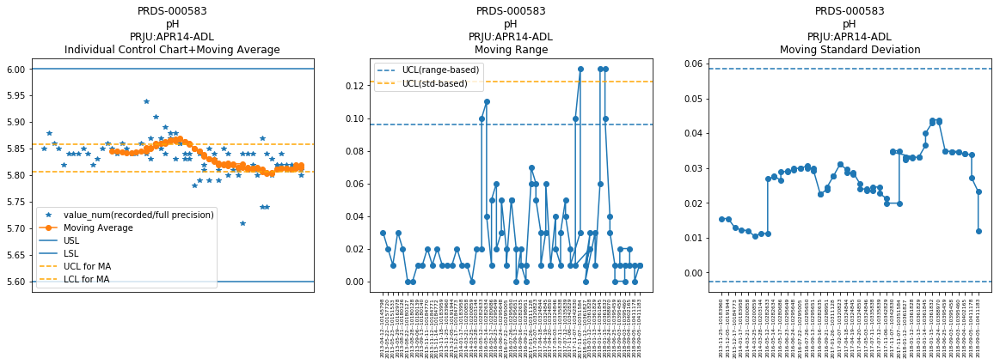

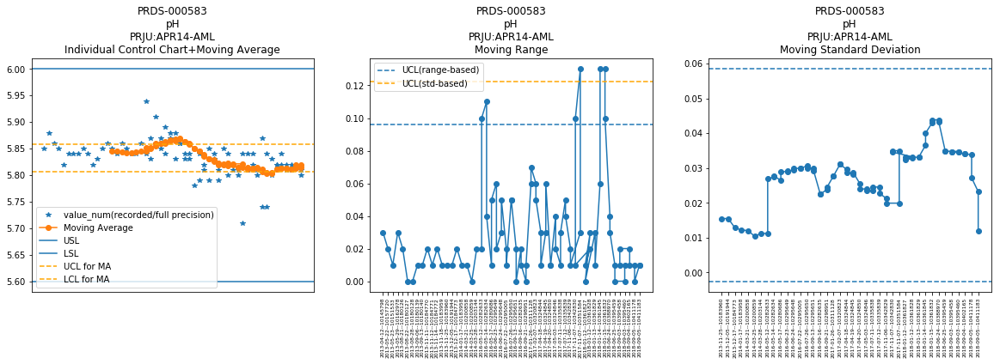

In [31]:
pp = PdfPages('Enbrel.pdf')
#plt.figure(figsize=(10,75))
for i in range(len(combs)):
    prds=combs["parameter detail"].iloc[i]
    para=combs["parameter name"].iloc[i]
    mfg=combs['mfg_site_bldg'].iloc[i]
    test=combs["test site"].iloc[i]
    sub_df=df_quan[(df_quan["parameter detail"]==prds)&(df_quan["parameter name"]==para)&(df_quan["mfg_site_bldg"]==mfg)&\
                  (df_quan["test site"]==test)].copy()
    sub_df=sub_df.sort_values(by=["date of manufacture","batch number"])
    if len(sub_df)>50:
        width=20
    else:
        width=10
    mostd=pd.rolling_std(sub_df['value_num(recorded/full precision)'],window=width)
    moavg=pd.rolling_mean(sub_df['value_num(recorded/full precision)'],window=width)
    mr=np.abs(np.diff(sub_df['value_num(recorded/full precision)']))
    mocv=mostd/moavg*100
    sample_std=np.std(sub_df['value_num(recorded/full precision)'],ddof=1)
    sample_mean=np.average(sub_df['value_num(recorded/full precision)'])
    indexes=mostd[mostd.notnull()].index
    ual=sub_df["UAL"].iloc[-1]
    lal=sub_df["LAL"].iloc[-1]
    #ax=plt.subplot(5,5,i+1)
    ax=plt.figure(figsize=(20,5))
    plt.subplot(1,3,1)
    plt.plot(sub_df["Mft_Date_Batch"],sub_df['value_num(recorded/full precision)'],"*")
    plt.plot(sub_df["Mft_Date_Batch"].loc[indexes],moavg[indexes],"-o",label="Moving Average")
    if (ual!="."):
        plt.axhline(y=ual,label="USL")
    if(lal!="."):
        plt.axhline(y=lal,label="LSL")  
    plt.axhline(y=sample_mean+3*sample_std/np.sqrt(width),label="UCL for MA",linestyle="--",color="orange")
    plt.axhline(y=sample_mean-3*sample_std/np.sqrt(width),label="LCL for MA",linestyle="--",color="orange")
    
    #plt.xticks([], [])
    plt.xticks(np.arange(len(sub_df["Mft_Date_Batch"]))[0::10],sub_df["Mft_Date_Batch"].iloc[0::10],rotation=90,fontsize=5)
    plt.title(prds+"\n"+para+"\n"+mfg+"-"+test+"\n"+"Individual Control Chart+Moving Average")
    plt.legend()
    #ax.set_title(prds+"\n"+para,fontsize=10)

    
    plt.subplot(1,3,2)
    plt.plot(sub_df["Mft_Date_Batch"].iloc[1:],mr,"-o")
    plt.axhline(y=3.267*np.average(mr),linestyle="--",label="UCL(range-based)")
    plt.axhline(3.678*sample_std,linestyle="--",label="UCL(std-based)",color="orange")
    plt.title(prds+"\n"+para+"\n"+mfg+"-"+test+"\n"+"Moving Range")   
    plt.xticks(rotation=90,fontsize=6)
    plt.legend()
    
    plt.subplot(1,3,3)
    plt.plot(sub_df["Mft_Date_Batch"].loc[indexes],mostd[indexes],"-o")
    plt.axhline(y=np.average(mostd[indexes])+3*np.average(mostd[indexes])*0.363,linestyle="--",label="UCL")
    plt.axhline(y=np.average(mostd[indexes])-3*np.average(mostd[indexes])*0.363,linestyle="--",label="LCL")
    plt.title(prds+"\n"+para+"\n"+mfg+"-"+test+"\n"+"Moving Standard Deviation")

    #plt.title(prds+"\n"+para+"\n"+mfg+"-"+test+"\n"+"Moving Coefficient of Variation(%)")
    
    plt.xticks(rotation=90,fontsize=6)
    
    plt.savefig(pp, format='pdf',bbox_inches="tight");
pp.close()